In [1]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

**Получить данные**

In [2]:
data = pd.read_csv('https://raw.githubusercontent.com/datasets/covid-19/main/data/countries-aggregated.csv')
data.head()

,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0


**Вывести таблицу с группировкой по стране**

In [3]:
# вариант 1
grouped = data.groupby(by='Country')
grouped.head()

,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0
...,...,...,...,...,...
155236,2020-01-22,Zimbabwe,0,0,0
155237,2020-01-23,Zimbabwe,0,0,0
155238,2020-01-24,Zimbabwe,0,0,0
155239,2020-01-25,Zimbabwe,0,0,0


In [4]:
# вариант 2
def summary(x):
    result = {
        'Confirmed': x['Confirmed'].sum(),
        'Recovered': x['Recovered'].sum(),
        'Deaths': x['Deaths'].sum()
    }
    return pd.Series(result).round(0)

result = data.groupby(['Country']).apply(summary)
result

,Confirmed,Recovered,Deaths
Country,,,
Afghanistan,61053723,18289880,2659416
Albania,74718862,22652652,1222890
Algeria,87256301,25670233,2459536
Andorra,8477797,3085649,71603
Angola,23649399,5895800,552094
...,...,...,...
West Bank and Gaza,168974831,57608773,1735549
Winter Olympics 2022,24537,0,0
Yemen,3657111,772497,750809


**Вывести гистограмму с тремя показателями (Confirmed, Recovered, Deaths)**

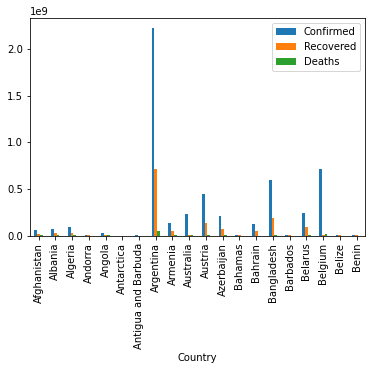

In [5]:
# вариант 1
result[0:20].plot(kind='bar');

In [7]:
# вариант 2
import plotly.graph_objects as go

result = result.reset_index(drop = False)
x = result['Country']

bar_plots = [
        go.Bar(x=x, y=result['Confirmed'], name='Confirmed', marker=go.bar.Marker(color='#FFEB3B')),
        go.Bar(x=x, y=result['Recovered'], name='Recovered', marker=go.bar.Marker(color='#8BC34A')),
        go.Bar(x=x, y=result['Deaths'], name='Deaths', marker=go.bar.Marker(color='#F44336')),
    ]

layout = go.Layout(
        title=go.layout.Title(text="Сoronovirus statistics", x=0.5),
        yaxis_title="Count",
        xaxis_tickmode="array",
        xaxis_tickvals=x,
        xaxis_ticktext=tuple(result['Country'].values),
    )

fig = go.Figure(data=bar_plots, layout=layout)
fig.show()

**Вывести линейную диаграмму с тремя показателями (Confirmed, Recovered, Deaths)**

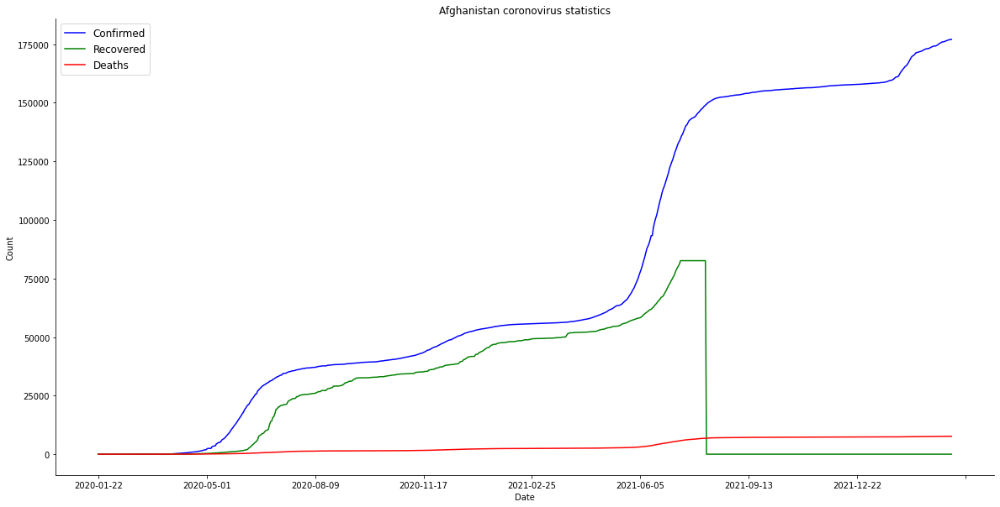

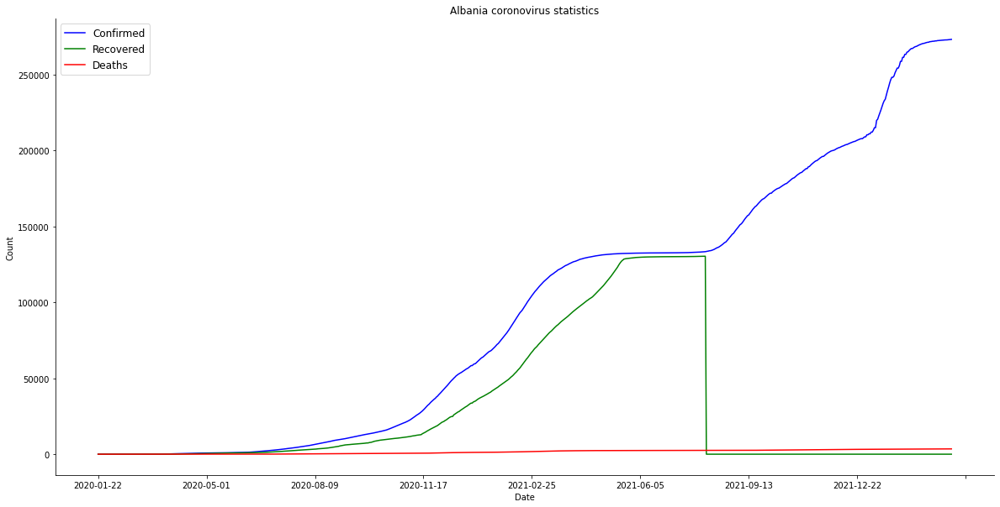

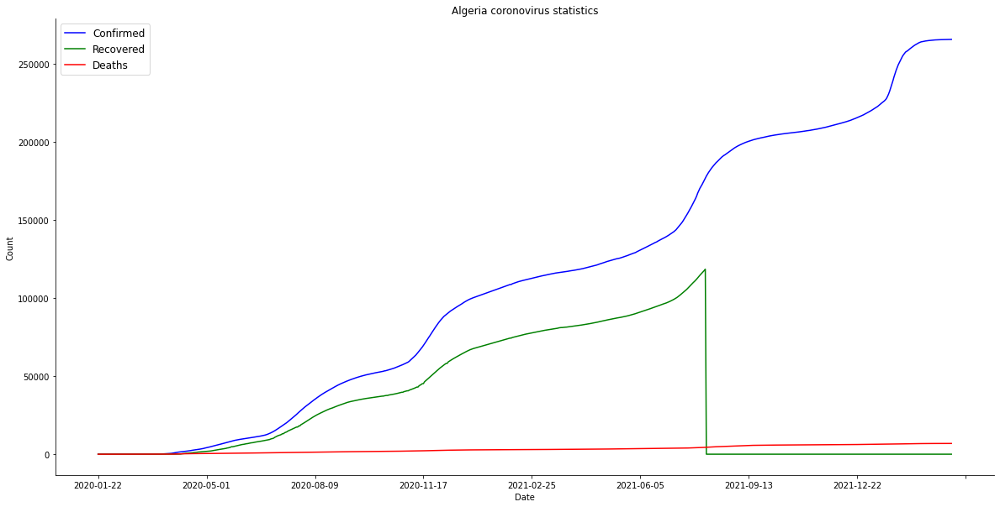

In [8]:
# вариант 1
data_confirmed = data[['Date', 'Country', 'Confirmed']]
data_confirmed = data_confirmed.set_index(data_confirmed['Date'])
data_recovered = data[['Date', 'Country', 'Recovered']]
data_recovered = data_recovered.set_index(data_recovered['Date'])
data_deaths = data[['Date', 'Country', 'Deaths']]
data_deaths = data_deaths.set_index(data_deaths['Date'])
uniq_country = data['Country'].unique()
count_country = len(uniq_country)

# постороим 3 графика вместо 198-ми (count_country) 
for i in range(0, 3): #count_country):
  fig = plt.figure()
  ax = fig.add_subplot(111)
  fig.set_figheight(10)
  fig.set_figwidth(20)
  fig.add_axes
  data_confirmed[data_confirmed['Country'] == uniq_country[i]].plot(ax = ax, color = 'blue') #, logy = True)
  ax.set(
         ylabel = 'Count',
         title = uniq_country[i] + u' coronovirus statistics')
  data_recovered[data_recovered['Country'] == uniq_country[i]].plot(ax = ax, color = 'green') #, logy = True)
  data_deaths[data_deaths['Country'] == uniq_country[i]].plot(ax = ax, color = 'red') #, logy = True)
  ax.legend(loc='upper left', fontsize='large')
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  plt.show()

In [9]:
# вариант 2
# постороим 3 графика вместо 198-ми (count_country)
for i in range(0, 3): #count_country):
  fig = go.Figure()
  fig.add_trace(go.Scatter(
      name = "Confirmed",
      x=data_confirmed.index,
      y=data_confirmed[data_confirmed['Country'] == uniq_country[i]]['Confirmed'],
      hovertext=data_confirmed[data_confirmed['Country'] == uniq_country[i]]['Confirmed'],
      hoverinfo="text",
      marker=dict(
          color="blue"
      ),
      showlegend=True
  ))
  fig.add_trace(go.Scatter(
      name = "Recovered",
      x=data_recovered.index,
      y=data_recovered[data_recovered['Country'] == uniq_country[i]]['Recovered'],
      hovertext=data_recovered[data_recovered['Country'] == uniq_country[i]]['Recovered'],
      hoverinfo="text",
      marker=dict(
          color="green"
      ),
      showlegend=True
  ))
  fig.add_trace(go.Scatter(
      name = "Deaths",
      x=data_deaths.index,
      y=data_deaths[data_deaths['Country'] == uniq_country[i]]['Deaths'],
      hovertext=data_deaths[data_deaths['Country'] == uniq_country[i]]['Deaths'],
      hoverinfo="text",
      marker=dict(
          color="red"
      ),
      showlegend=True
  ))

  fig.update_layout(
      yaxis_title='Count',
      title= uniq_country[i] + " coronovirus statistics",
      title_x=0.5
  )
  fig.update_xaxes(rangeslider_visible=True)
  fig.show()

**Придумать свой график**

In [14]:
import plotly.express as px

result['Confirmed_percent'] = (result['Confirmed'] / result['Confirmed'].sum()) * 100

fig = px.treemap(result,
                 path=['Country'],
                 values='Confirmed_percent',
                 color='Confirmed',
                 color_continuous_scale='RdBu',
                 width=1000, height=600,
                 title="Сoronovirus statistics")
fig.update_layout(
      title_x=0.5
  )
fig.show()